In [ ]:
import cv2
import os
import matplotlib.pyplot as plt
from google.colab.patches import cv2_imshow

In [ ]:
!git clone https://github.com/junyanz/pytorch-CycleGAN-and-pix2pix

fatal: destination path 'pytorch-CycleGAN-and-pix2pix' already exists and is not an empty directory.


In [ ]:
%cd pytorch-CycleGAN-and-pix2pix/

/content/pytorch-CycleGAN-and-pix2pix


In [ ]:
!pip install -r requirements.txt

Models: http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/

In [ ]:
model_name = "horse2zebra"

In [ ]:
model_directory = "./checkpoints/{}_pretrained/".format(model_name)
model_directory

'./checkpoints/horse2zebra_pretrained/'

In [ ]:
!mkdir -p {model_directory}

In [ ]:
url_model = "http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/{}.pth".format(model_name)

In [ ]:
!wget -N {url_model}
!mv {model_name}.pth {model_directory}latest_net_G.pth

--2024-02-13 12:43:21--  http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/horse2zebra.pth
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45575747 (43M)
Saving to: ‘horse2zebra.pth’

horse2zebra.pth     100%[===================>]  43.46M  12.6MB/s    in 3.6s    

2024-02-13 12:43:25 (12.0 MB/s) - ‘horse2zebra.pth’ saved [45575747/45575747]



In [ ]:
!mkdir -p images/horses/

Test the model

In [ ]:
!python test.py --dataroot images/horses --name {model_name}_pretrained --model test --no_dropout

----------------- Options ---------------
             aspect_ratio: 1.0                           
               batch_size: 1                             
          checkpoints_dir: ./checkpoints                 
                crop_size: 256                           
                 dataroot: images/horses                 	[default: None]
             dataset_mode: single                        
                direction: AtoB                          
          display_winsize: 256                           
                    epoch: latest                        
                     eval: False                         
                  gpu_ids: 0                             
                init_gain: 0.02                          
                init_type: normal                        
                 input_nc: 3                             
                  isTrain: False                         	[default: None]
                load_iter: 0                            

In [ ]:
results_directory = "./results/{}_pretrained/test_latest/images/".format(model_name)

In [ ]:
example_image = "horse"

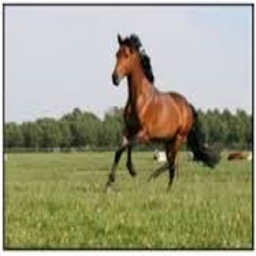

In [ ]:
result_img = cv2.imread(results_directory + "{}_real.png".format(example_image))
cv2_imshow(result_img)

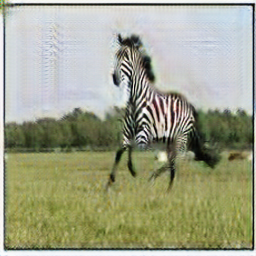

In [ ]:
result_img = cv2.imread(results_directory + "{}_fake.png".format(example_image))
cv2_imshow(result_img)

In [ ]:
example_image = "horse2"

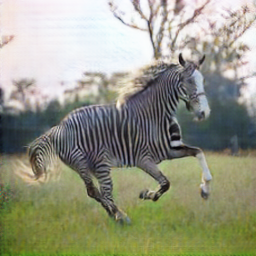

In [ ]:
result_img = cv2.imread(results_directory + "{}_fake.png".format(example_image))
cv2_imshow(result_img)

In [ ]:
def show_results(img_name, directory):
  input_img = cv2.imread(directory + img_name + "_real.png")
  result_img = cv2.imread(directory + img_name + "_fake.png")

  imgs = [input_img, result_img]
  output = ["Original", "Output"]

  plt.figure(figsize=(10, 6))
  for i in range(len(imgs)):
    plt.subplot(1, 2, i+1)
    plt.title(output[i])
    plt.axis("off")
    plt.imshow(cv2.cvtColor(imgs[i], cv2.COLOR_BGR2RGB))
  plt.show()

In [ ]:
dir_imgs = "images/horses"
list_imgs = [os.path.splitext(f)[0] for f in os.listdir(dir_imgs) if f.endswith(".jpg")]
list_imgs

['horse2', 'horse']


Result for image horse2:


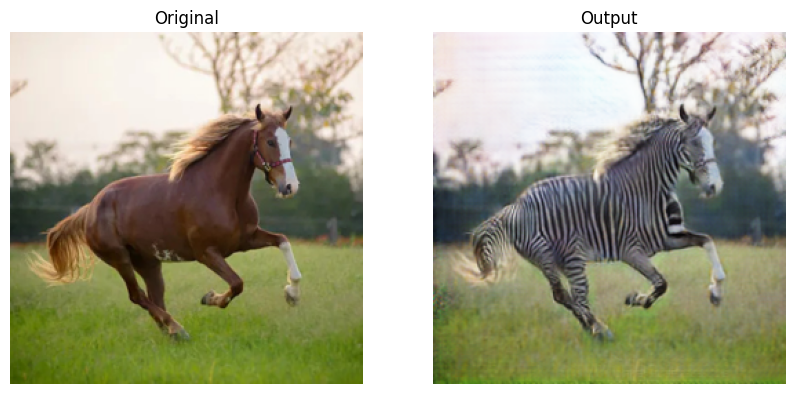


Result for image horse:


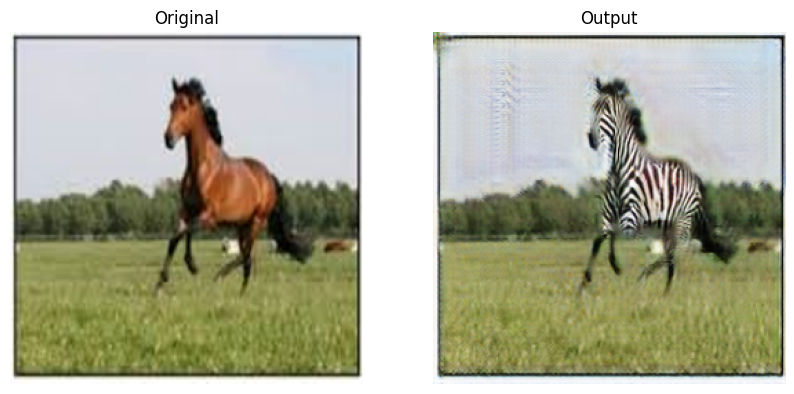

In [ ]:
for img in list_imgs:
  print("\nResult for image {}:".format(img))
  show_results(img, results_directory)

### STYLE TRANSFER - PHOTO2PAINTING

MONET STYLE

In [ ]:
model_name = 'style_monet'
model_directory = './checkpoints/{}_pretrained/'.format(model_name)

In [ ]:
!mkdir -p {model_directory}

In [ ]:
url_model = "http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/{}.pth".format(model_name)
!wget -N {url_model}
!mv {model_name}.pth {model_directory}/latest_net_G.pth

--2024-02-13 14:31:06--  http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/style_monet.pth
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45575747 (43M)
Saving to: ‘style_monet.pth’

style_monet.pth     100%[===================>]  43.46M  12.6MB/s    in 3.6s    

2024-02-13 14:31:10 (12.0 MB/s) - ‘style_monet.pth’ saved [45575747/45575747]



In [ ]:
!python test.py --dataroot images/mixed/ --name {model_name}_pretrained --model test --no_dropout

----------------- Options ---------------
             aspect_ratio: 1.0                           
               batch_size: 1                             
          checkpoints_dir: ./checkpoints                 
                crop_size: 256                           
                 dataroot: images/mixed/                 	[default: None]
             dataset_mode: single                        
                direction: AtoB                          
          display_winsize: 256                           
                    epoch: latest                        
                     eval: False                         
                  gpu_ids: 0                             
                init_gain: 0.02                          
                init_type: normal                        
                 input_nc: 3                             
                  isTrain: False                         	[default: None]
                load_iter: 0                            

In [ ]:
results_directory = "./results/{}_pretrained/test_latest/images/".format(model_name)
dir_imgs = "images/mixed/"
list_imgs = [os.path.splitext(f)[0] for f in os.listdir(dir_imgs) if f.endswith(".jpg") or f.endswith(".png")]
list_imgs

['flowers',
 'lego',
 'horse2',
 'urban2',
 'river',
 'city',
 'horse - Copy',
 'train',
 'hammer',
 'bridge',
 'horse',
 'butterfly',
 'urban']


Result for image flowers:


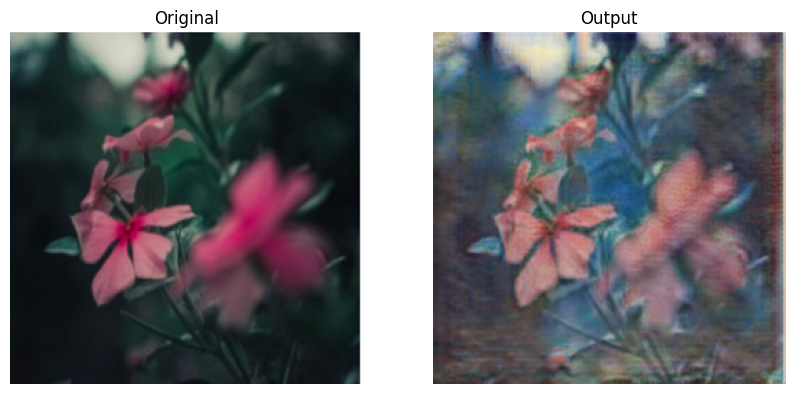


Result for image lego:


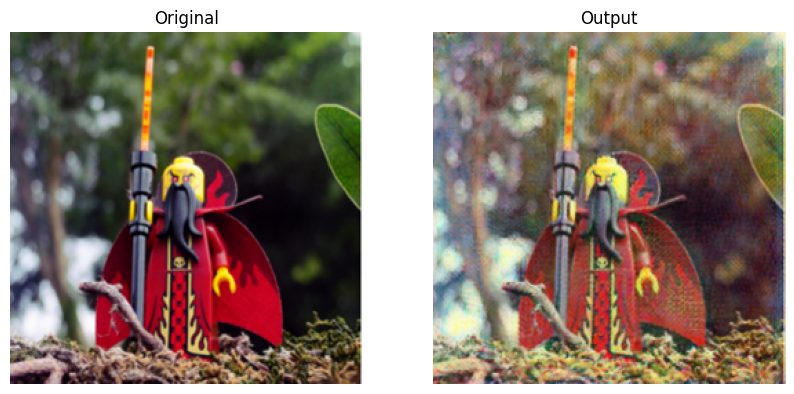


Result for image horse2:


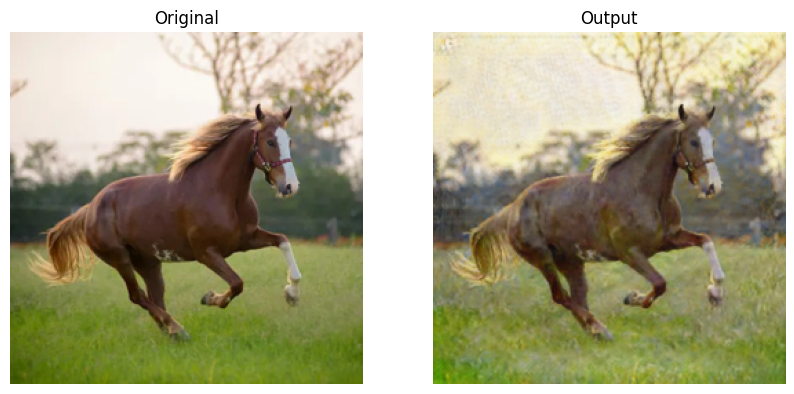


Result for image urban2:


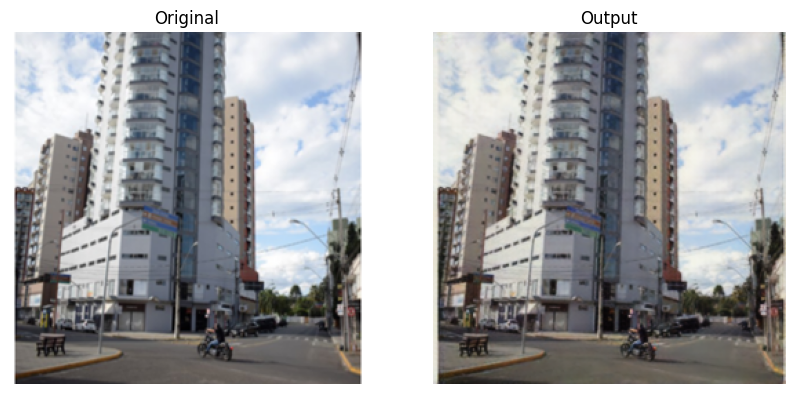


Result for image river:


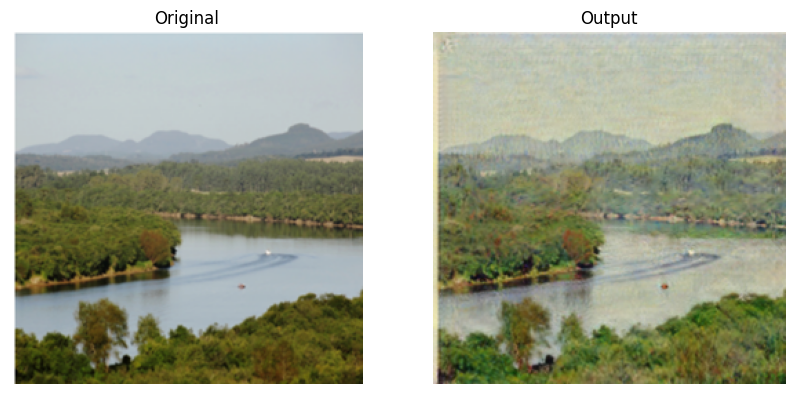


Result for image city:


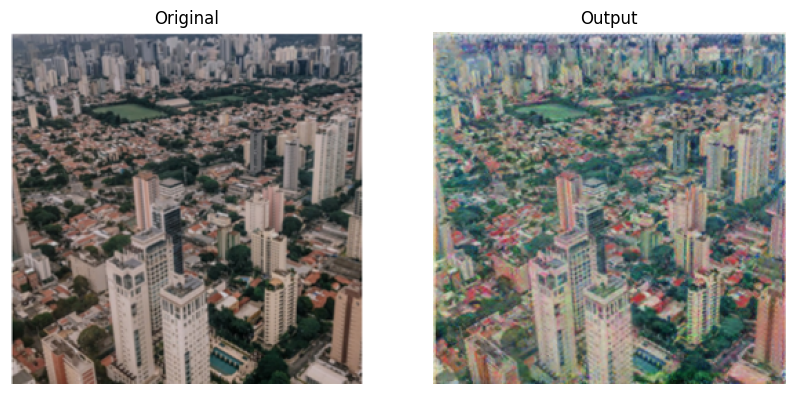


Result for image horse - Copy:


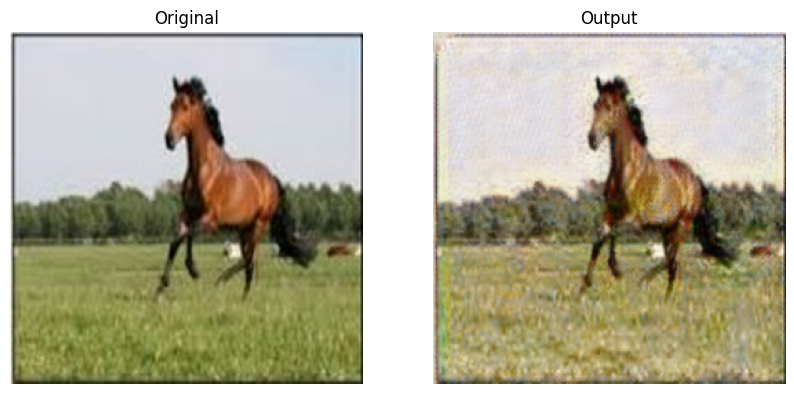


Result for image train:


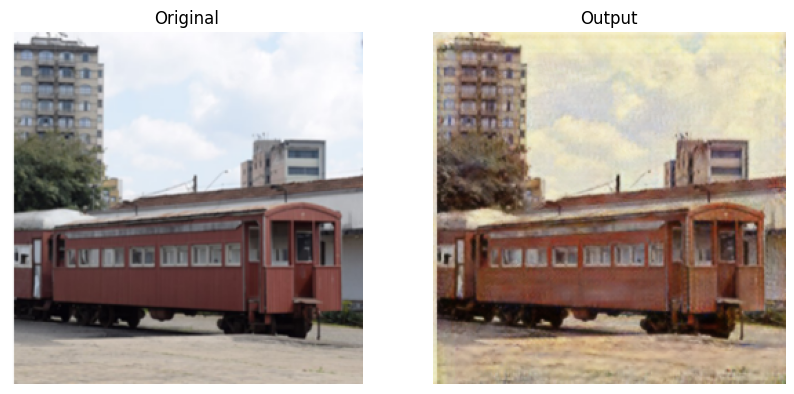


Result for image hammer:


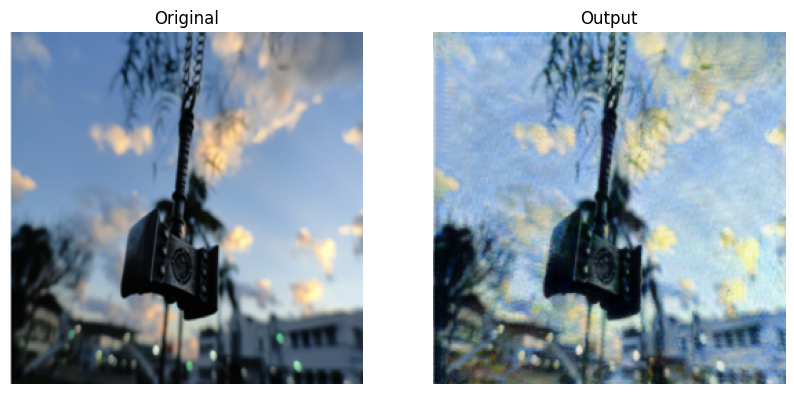


Result for image bridge:


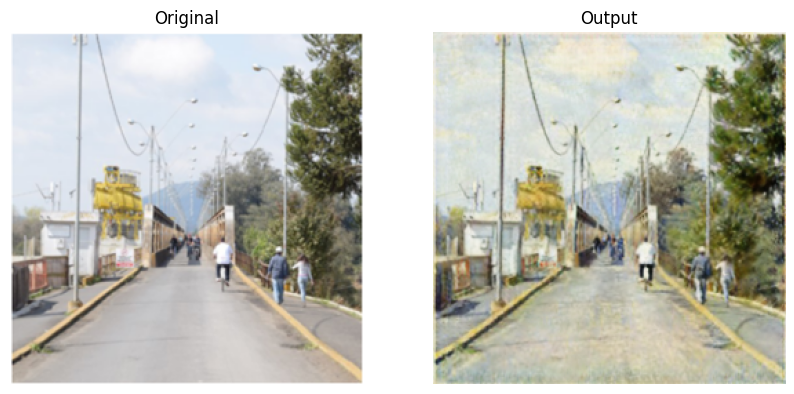


Result for image horse:


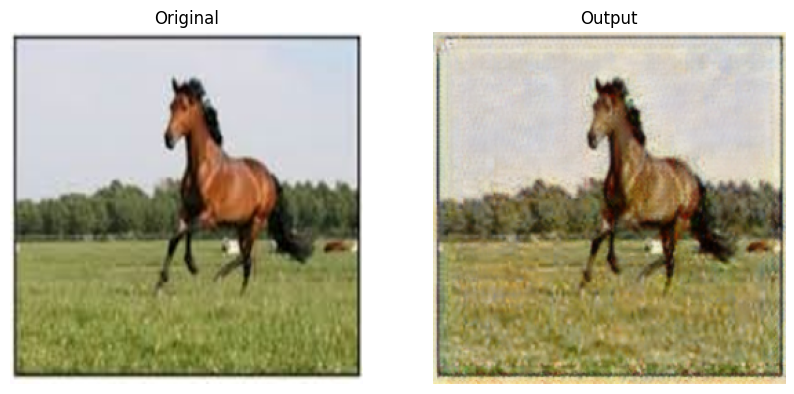


Result for image butterfly:


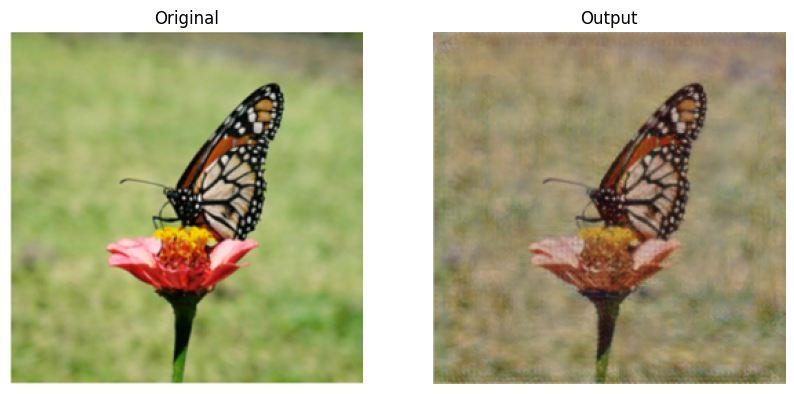


Result for image urban:


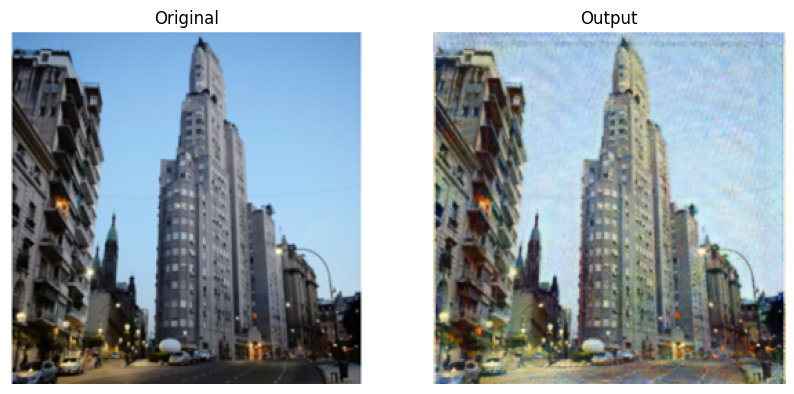

In [ ]:
for img in list_imgs:
  print("\nResult for image {}:".format(img))
  show_results(img, results_directory)

VAN GOGH STYLE

In [ ]:
model_name = 'style_vangogh'
model_directory = './checkpoints/{}_pretrained/'.format(model_name)
!mkdir -p {model_directory}
url_model = "http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/{}.pth".format(model_name)
!wget -N {url_model}
!mv {model_name}.pth {model_directory}/latest_net_G.pth

--2024-02-13 14:41:50--  http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/style_vangogh.pth
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45575747 (43M)
Saving to: ‘style_vangogh.pth’

style_vangogh.pth   100%[===================>]  43.46M  12.6MB/s    in 3.6s    

2024-02-13 14:41:54 (12.0 MB/s) - ‘style_vangogh.pth’ saved [45575747/45575747]



In [ ]:
!python test.py --dataroot images/mixed/ --name {model_name}_pretrained --model test --no_dropout

----------------- Options ---------------
             aspect_ratio: 1.0                           
               batch_size: 1                             
          checkpoints_dir: ./checkpoints                 
                crop_size: 256                           
                 dataroot: images/mixed/                 	[default: None]
             dataset_mode: single                        
                direction: AtoB                          
          display_winsize: 256                           
                    epoch: latest                        
                     eval: False                         
                  gpu_ids: 0                             
                init_gain: 0.02                          
                init_type: normal                        
                 input_nc: 3                             
                  isTrain: False                         	[default: None]
                load_iter: 0                            

In [ ]:
def results(model_name):
  results_directory = "./results/{}_pretrained/test_latest/images/".format(model_name)
  dir_imgs = "images/mixed/"
  list_imgs = [os.path.splitext(f)[0] for f in os.listdir(dir_imgs) if f.endswith(".jpg") or f.endswith(".png")]
  for img in list_imgs:
    print("\nResult for image {}:".format(img))
    show_results(img, results_directory)



Result for image flowers:


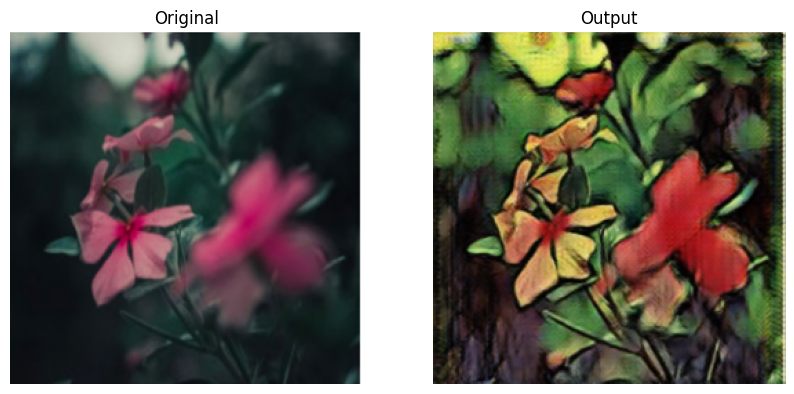


Result for image lego:


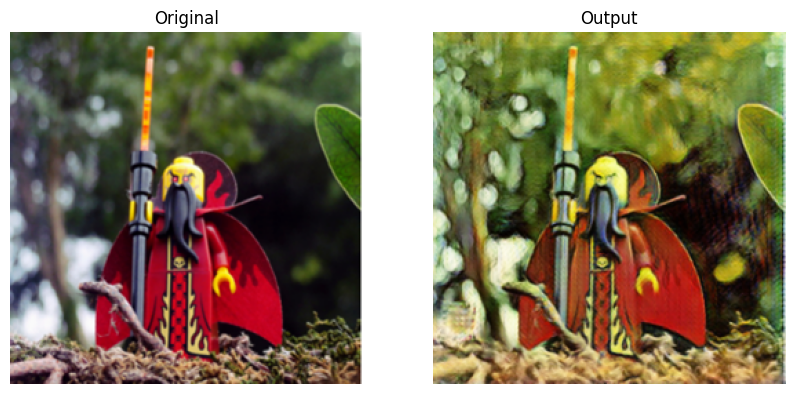


Result for image horse2:


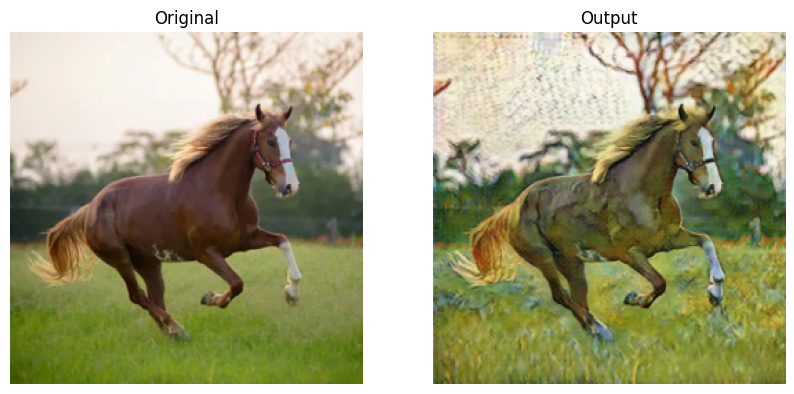


Result for image urban2:


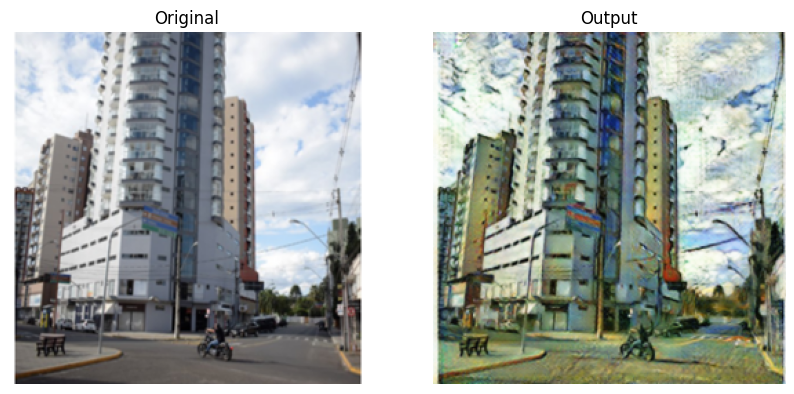


Result for image river:


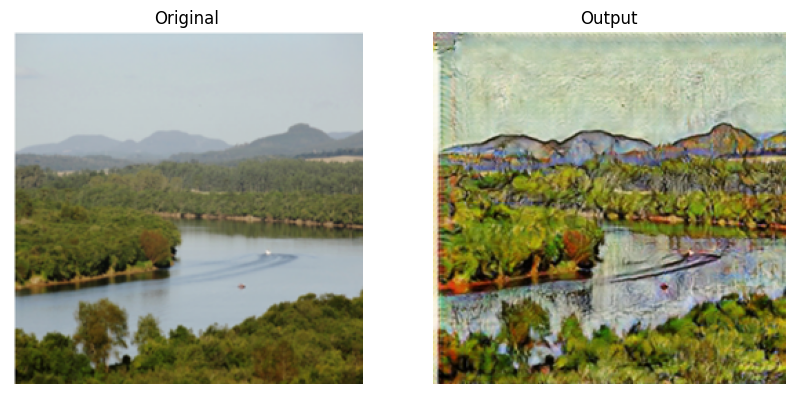


Result for image city:


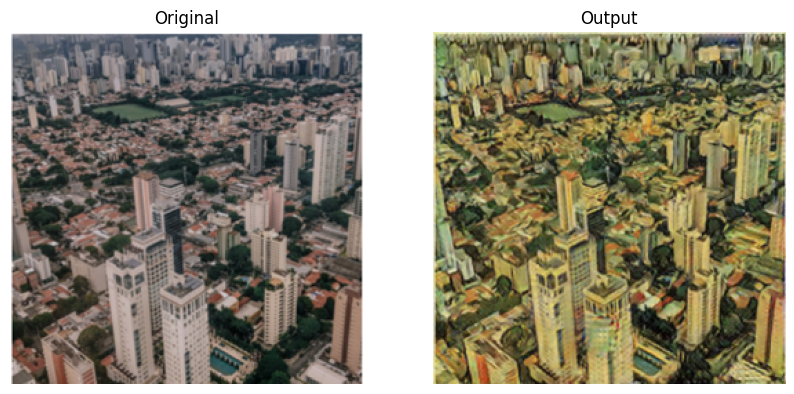


Result for image horse - Copy:


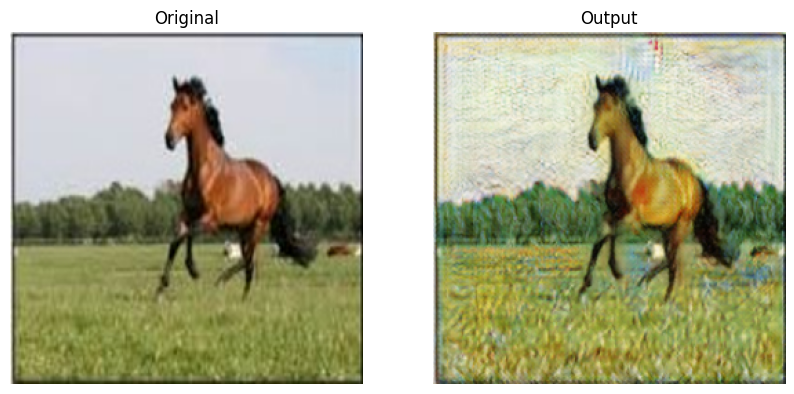


Result for image train:


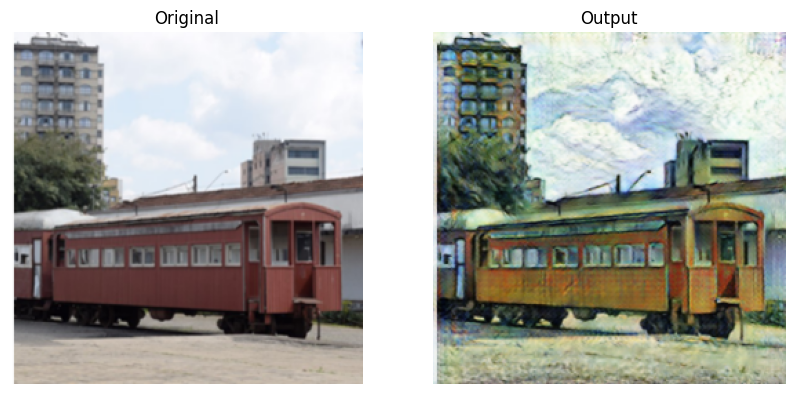


Result for image hammer:


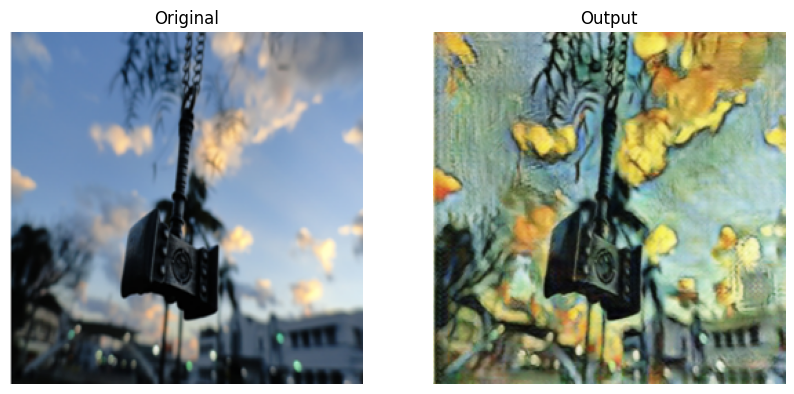


Result for image bridge:


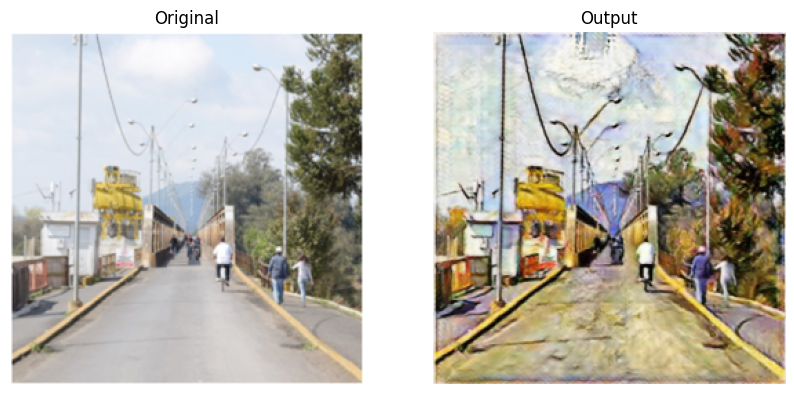


Result for image horse:


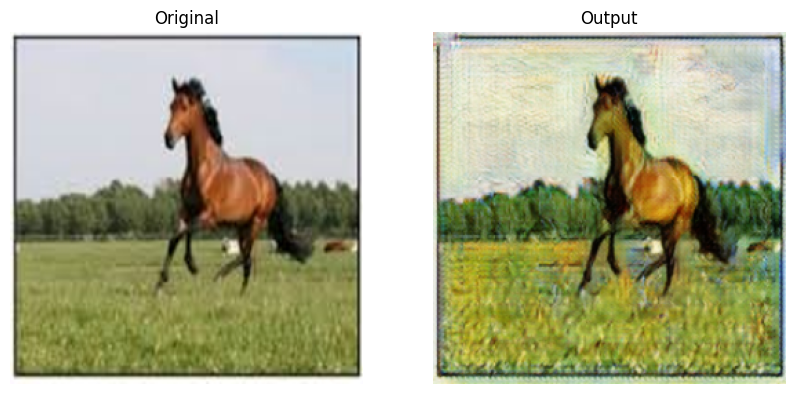


Result for image butterfly:


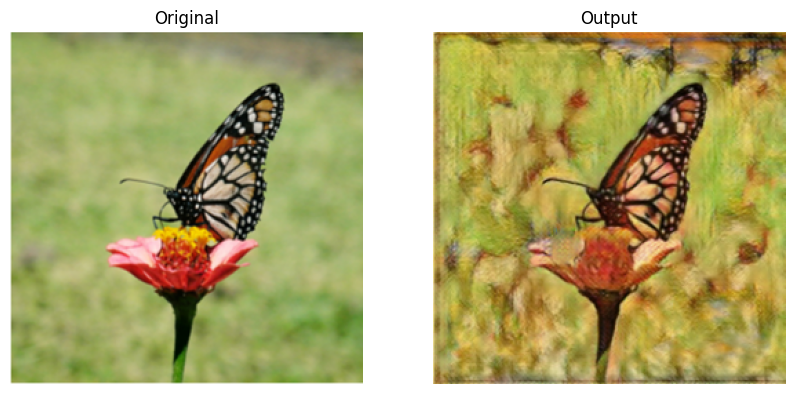


Result for image urban:


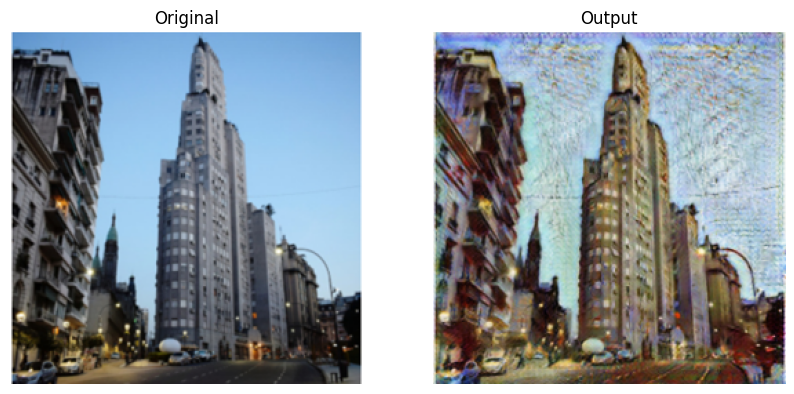

In [ ]:
results(model_name)

CEZANNE STYLE

In [ ]:
def model_download(model_name):
  #model_name = 'style_vangogh'
  model_directory = './checkpoints/{}_pretrained/'.format(model_name)
  !mkdir -p {model_directory}
  url_model = "http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/{}.pth".format(model_name)
  !wget -N {url_model}
  !mv {model_name}.pth {model_directory}/latest_net_G.pth

In [ ]:
model_download('style_cezanne')

--2024-02-13 14:46:42--  http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/style_cezanne.pth
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45575747 (43M)
Saving to: ‘style_cezanne.pth’

style_cezanne.pth   100%[===================>]  43.46M  12.5MB/s    in 3.6s    

2024-02-13 14:46:47 (12.0 MB/s) - ‘style_cezanne.pth’ saved [45575747/45575747]



In [ ]:
!python test.py --dataroot images/ --name {'style_cezanne'}_pretrained --model test --no_dropout

----------------- Options ---------------
             aspect_ratio: 1.0                           
               batch_size: 1                             
          checkpoints_dir: ./checkpoints                 
                crop_size: 256                           
                 dataroot: images/                       	[default: None]
             dataset_mode: single                        
                direction: AtoB                          
          display_winsize: 256                           
                    epoch: latest                        
                     eval: False                         
                  gpu_ids: 0                             
                init_gain: 0.02                          
                init_type: normal                        
                 input_nc: 3                             
                  isTrain: False                         	[default: None]
                load_iter: 0                            

In [ ]:
results('style_cezanne')

UKIYO-E STYLE

In [ ]:
model_download('style_ukiyoe')

--2024-02-13 14:48:17--  http://efrosgans.eecs.berkeley.edu/cyclegan/pretrained_models/style_ukiyoe.pth
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.244.190
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.244.190|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 45575747 (43M)
Saving to: ‘style_ukiyoe.pth’

style_ukiyoe.pth    100%[===================>]  43.46M  12.6MB/s    in 3.6s    

2024-02-13 14:48:21 (12.0 MB/s) - ‘style_ukiyoe.pth’ saved [45575747/45575747]



In [ ]:
!python test.py --dataroot images/ --name {'style_ukiyoe'}_pretrained --model test --no_dropout

----------------- Options ---------------
             aspect_ratio: 1.0                           
               batch_size: 1                             
          checkpoints_dir: ./checkpoints                 
                crop_size: 256                           
                 dataroot: images/                       	[default: None]
             dataset_mode: single                        
                direction: AtoB                          
          display_winsize: 256                           
                    epoch: latest                        
                     eval: False                         
                  gpu_ids: 0                             
                init_gain: 0.02                          
                init_type: normal                        
                 input_nc: 3                             
                  isTrain: False                         	[default: None]
                load_iter: 0                            


Result for image flowers:


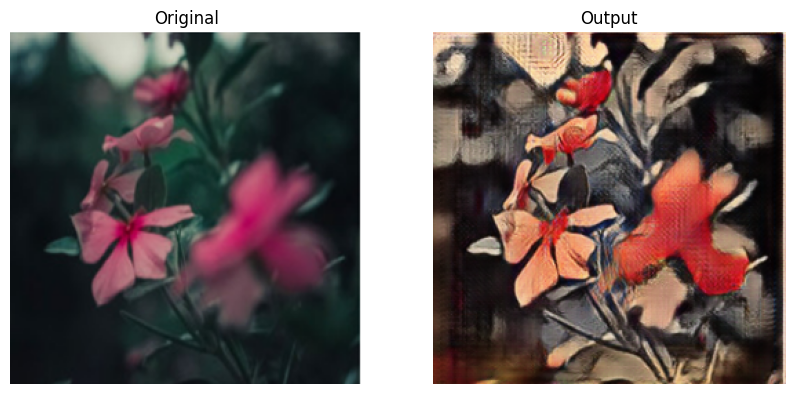


Result for image lego:


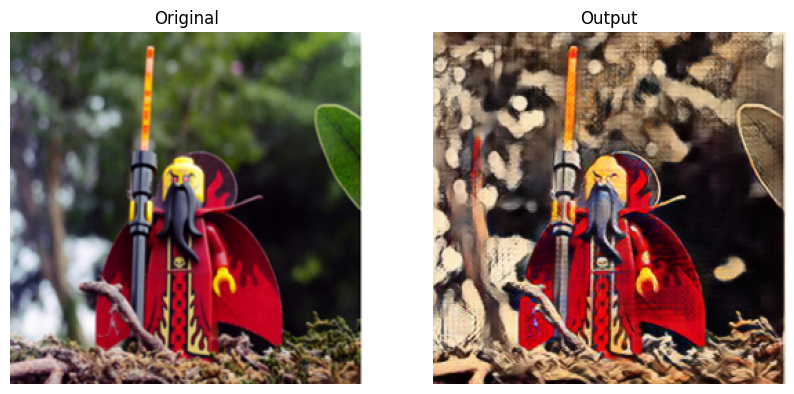


Result for image horse2:


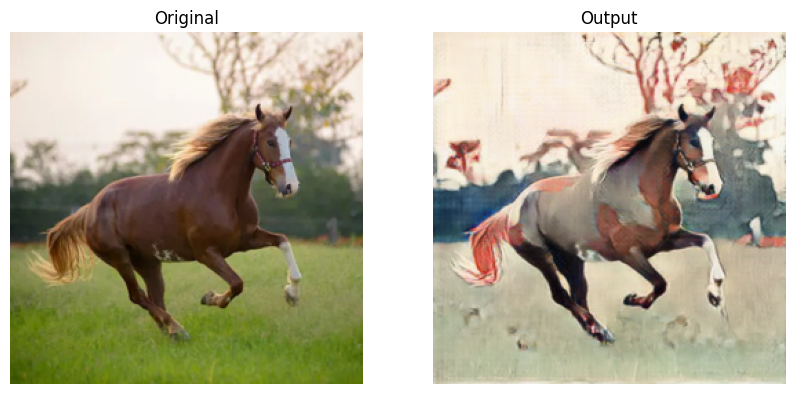


Result for image urban2:


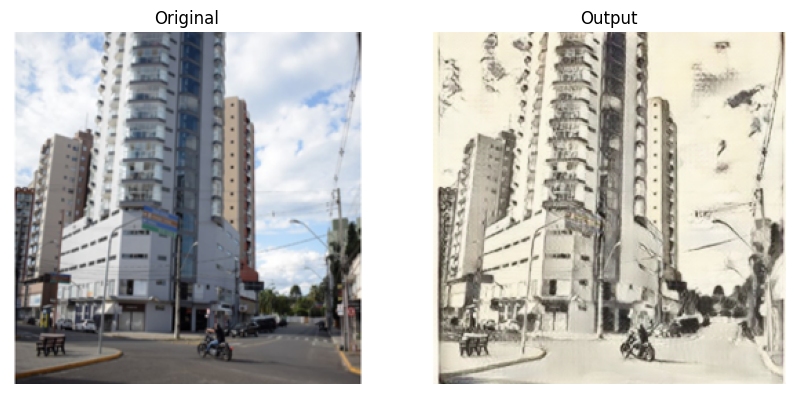


Result for image river:


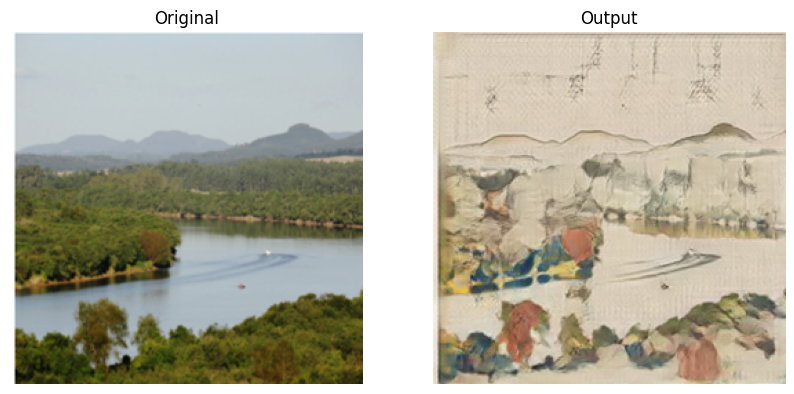


Result for image city:


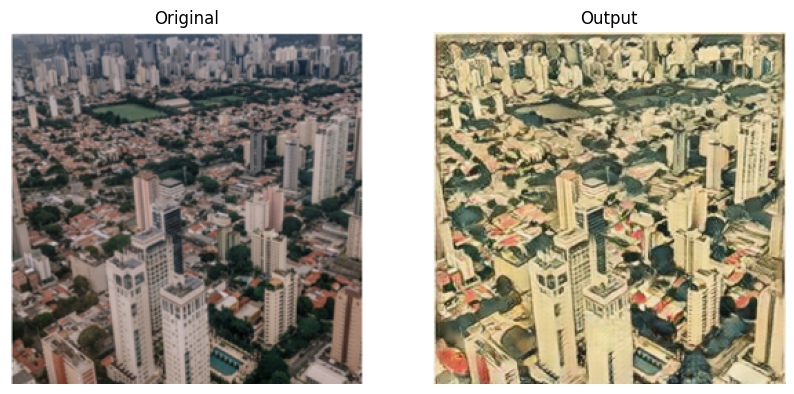


Result for image horse - Copy:


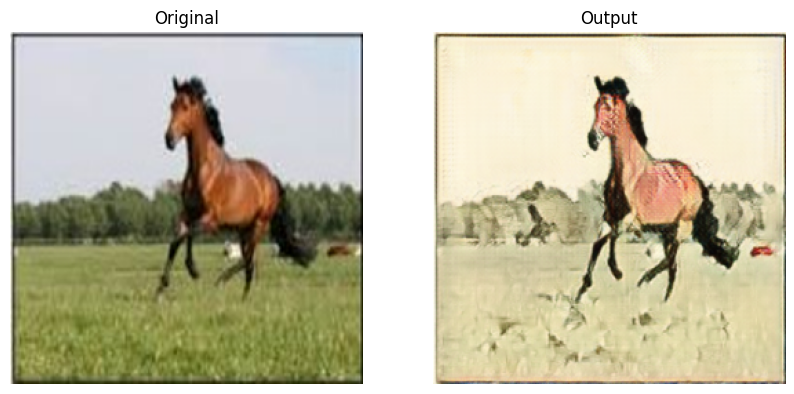


Result for image train:


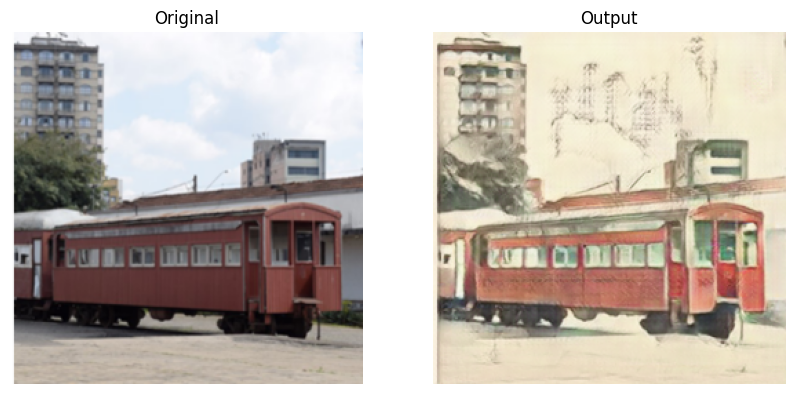


Result for image hammer:


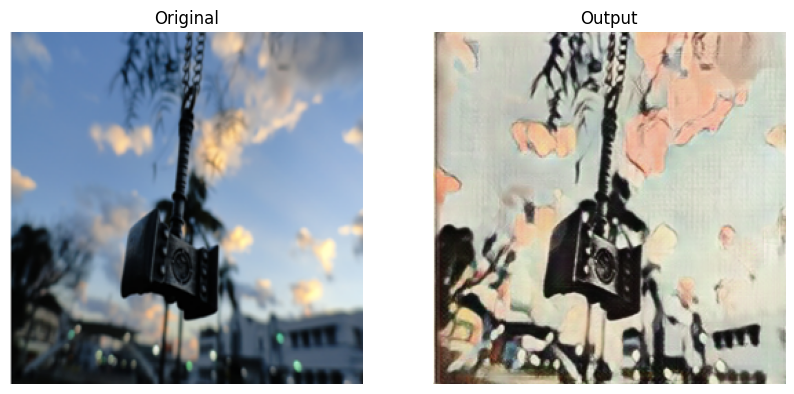


Result for image bridge:


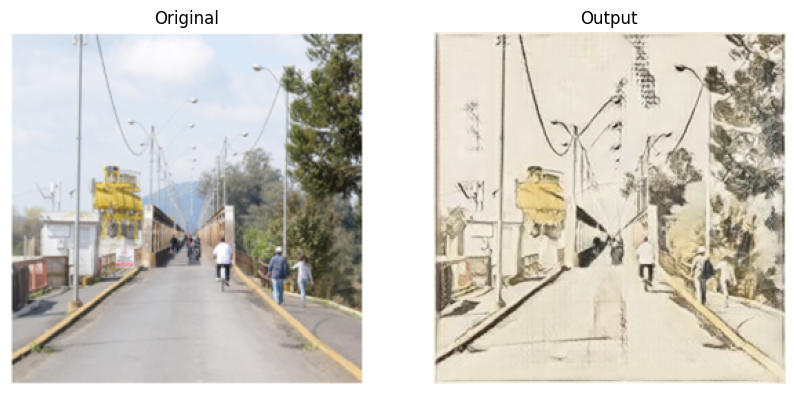


Result for image horse:


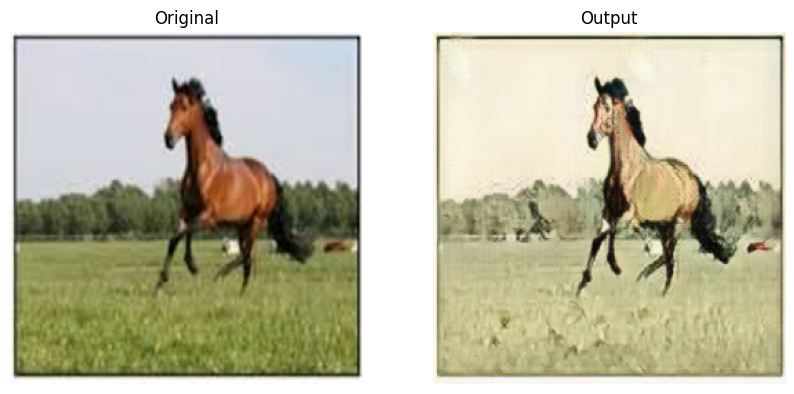


Result for image butterfly:


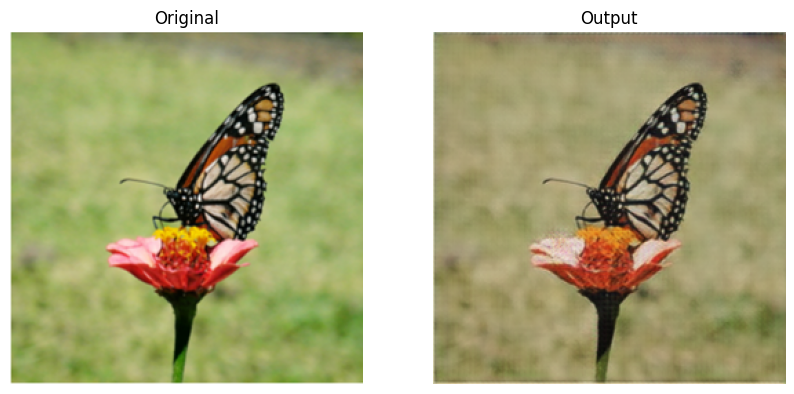


Result for image urban:


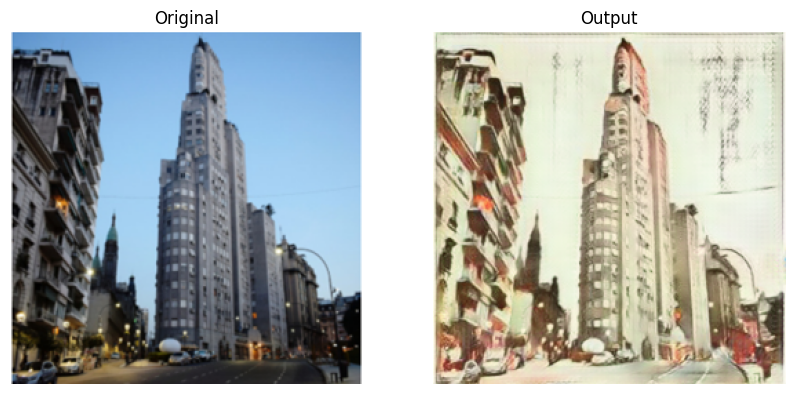

In [ ]:
results('style_ukiyoe')